<a href="https://colab.research.google.com/github/subhajit-dutta-bio/TCGA_SKCM_WSI/blob/main/TCGA_SKCM_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# This code will mount Google Drive to your Colab. Give permission to access drive
from google.colab import drive
import os

# Mount Google Drive
drive.mount('/content/drive')

# Define the path to the new directory
new_folder_path = '/content/drive/My Drive/TCGA_SKCM_WSI'

# Check if the directory already exists, if not, create it
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)
    print(f"Directory '{new_folder_path}' created.")
else:
    print(f"Directory '{new_folder_path}' already exists.")

# Change the current working directory
os.chdir(new_folder_path)

# Verify the current working directory
print("Current Working Directory: ", os.getcwd())

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Directory '/content/drive/My Drive/TCGA_SKCM_WSI' already exists.
Current Working Directory:  /content/drive/My Drive/TCGA_SKCM_WSI


In [ ]:
#Install all packages for the analysis
!pip install openslide-python
!apt-get install openslide-tools
!pip install opencv-python-headless
!pip install scikit-learn
!pip install torch torchvision
!pip install keras
!pip install tensorflow
!pip install tqdm
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.0/359.0 kB 20.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for openslide-python: filename=openslide_python-1.3.1-cp310-cp310-linux_x86_64.whl size=33549 sha256=e8c29545786913b4bc5ef7c09a482abb95c7aa6870d1f72adcdce2c5e07e4980
  Stored in directory: /root/.cache/pip/wheels/79/79/fa/29a0087493c69dff7fd0b70fab5d6771002a531010161d2d97
Successfully built openslide-python
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libopenslide0
Suggested packages:
  libtiff-tools
The following NEW packages will be installed:
  libopenslide0 openslide-tools
0 upgraded, 2 newly installed, 0 to remove and 49 not upgraded.
Need to get 104 kB of archives.
After this operation, 297 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libopenslide0 amd64 3.4.1+dfsg-5build1 [89.8 kB

In [ ]:
# Downscale the raw images 2 times and save them in png format
import openslide
import cv2
import os
import numpy as np

# Define input and output directories
metastatic_input_dir = os.path.join(new_folder_path, 'Metastatic_WSI')
metastatic_output_dir = os.path.join(new_folder_path, 'Metastatic_downsize_WSI_final')

# Create output directories if they do not exist
os.makedirs(metastatic_output_dir, exist_ok=True)

# Function to downscale images
def downscale_images(input_dir, output_dir, downscale_factor=2):  # Change the downscale factor to 2
    for filename in os.listdir(input_dir):
        if filename.endswith('.svs'):
            filepath = os.path.join(input_dir, filename)
            with openslide.OpenSlide(filepath) as slide:
                # Read the full-resolution slide and convert it to an array
                level = 1
                img = slide.read_region((0, 0), level, slide.level_dimensions[level])
                img = cv2.cvtColor(np.array(img), cv2.COLOR_RGBA2RGB)

                # Calculate new dimensions
                new_width = img.shape[1] // downscale_factor
                new_height = img.shape[0] // downscale_factor
                resized_img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_AREA)

                # Save the resized image as a PNG or JPEG
                output_filepath = os.path.join(output_dir, filename.replace('.svs', '_downscaled.png'))
                cv2.imwrite(output_filepath, resized_img)
                print(f"Saved {output_filepath}")

# Downscale images in both directories
downscale_images(metastatic_input_dir, metastatic_output_dir, downscale_factor=2)

Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-DA-A95Y-06A-01-TSA.B8F01A4D-77BF-421D-BA27-9334B515B246_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-ER-A19F-06A-01-TSA.6DED71EF-3ABD-4309-A9DF-FEC2FFCCB6A5_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-EE-A3AG-06A-03-TSC.D5810E89-9E09-4599-82FD-73971EFDEE8E_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-EE-A185-06A-01-TS1.9C0599A3-CD2E-47C9-A46B-76E978394DE5_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-DA-A1I1-06A-01-TSA.DCC9159E-79DD-4CE0-80C4-1D494F602E56_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-EE-A29L-06A-01-TSA.ACA56C7A-3791-43A2-A515-3ACF1D639138_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Metastatic_downsize_WSI_final/TCGA-EE-A29E-06A-01-TSA.DE

In [ ]:
# Downscale the raw images 2 times and save them in png format
import openslide
import cv2
import os
import numpy as np

# Define input and output directories

primary_input_dir = os.path.join(new_folder_path, 'Primary_WSI')
primary_output_dir = os.path.join(new_folder_path, 'Primary_downsize_WSI_final')

# Create output directories if they do not exist

os.makedirs(primary_output_dir, exist_ok=True)

# Function to downscale images
def downscale_images(input_dir, output_dir, downscale_factor=2):  # Change the downscale factor to 2
    for filename in os.listdir(input_dir):
        if filename.endswith('.svs'):
            filepath = os.path.join(input_dir, filename)
            with openslide.OpenSlide(filepath) as slide:
                # Read the full-resolution slide and convert it to an array
                level = 1
                img = slide.read_region((0, 0), level, slide.level_dimensions[level])
                img = cv2.cvtColor(np.array(img), cv2.COLOR_RGBA2RGB)

                # Calculate new dimensions
                new_width = img.shape[1] // downscale_factor
                new_height = img.shape[0] // downscale_factor
                resized_img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_AREA)

                # Save the resized image as a PNG or JPEG
                output_filepath = os.path.join(output_dir, filename.replace('.svs', '_downscaled.png'))
                cv2.imwrite(output_filepath, resized_img)
                print(f"Saved {output_filepath}")

# Downscale images in both directories

downscale_images(primary_input_dir, primary_output_dir, downscale_factor=2)

Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-BF-AAP1-01A-01-TSA.E76C5B4A-057A-4A77-83A7-94491795D9A4_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-BF-A3DJ-01A-01-TSA.6B7B7883-43E9-42F8-AF41-A081A77512BC_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-EB-A6QY-01A-01-TSA.53AA5C6B-C5AA-4C2E-B9AA-42A85E9C9E59_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-ER-A196-01A-01-TSA.4B18912C-0D98-4CBB-A52B-635929A1891B_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-EB-A5VU-01A-02-TSB.ED27865D-F0B4-46E8-AE93-A85AE6C6B7C3_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-BF-A3DL-01A-01-TS1.7CB692B2-29CD-4C30-8126-AD75A2E991F8_downscaled.png
Saved /content/drive/My Drive/TCGA_SKCM_WSI/Primary_downsize_WSI_final/TCGA-EB-A553-01A-01-TSA.E4A4DAF2-FF9B-4A42-B4E1

In [ ]:
#Patch extraction from the whole slide images
import os
import cv2
import numpy as np
from tqdm import tqdm
from PIL import Image
from skimage.filters import threshold_otsu
from skimage.morphology import remove_small_objects, remove_small_holes
from scipy.ndimage import binary_fill_holes  # Import from scipy.ndimage


# --- Helper Functions ---

def segment_tissue(image, seg_level=0, sthresh=8, mthresh=7, close=4, use_otsu=False, keep_ids='none',
                   exclude_ids='none', filter_params={'a_t': 100, 'a_h': 16, 'max_n_holes': 8}):
    """Segments tissue from the image."""

    # 1. Downsample if necessary
    if seg_level > 0:
        image = cv2.resize(image, None, fx=1 / 2 ** seg_level, fy=1 / 2 ** seg_level,
                          interpolation=cv2.INTER_AREA)

    # 2. Convert to HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # 3. Thresholding (Otsu or fixed)
    if use_otsu:
        _, mask = cv2.threshold(hsv_image[:, :, 1], 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    else:
        mask = (hsv_image[:, :, 1] > sthresh) & (hsv_image[:, :, 2] > mthresh)
        mask = (mask * 255).astype(np.uint8)

    # 4. Morphological Operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (close, close))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    # 5. Filter small objects and holes (using skimage)
    mask = remove_small_objects(mask.astype(bool), min_size=filter_params['a_t'])
    mask = remove_small_holes(mask, area_threshold=filter_params['a_h'])
    mask = binary_fill_holes(mask)
    mask = (mask * 255).astype(np.uint8)

    return mask


def create_patches(image, mask, patch_level=0, patch_size=256, step_size=256, white_thresh=5,
                   black_thresh=40, use_padding=True, contour_fn='four_pt'):
    """Extracts patches from the image based on the mask."""

    # 1. Downsample if necessary
    if patch_level > 0:
        image = cv2.resize(image, None, fx=1 / 2 ** patch_level, fy=1 / 2 ** patch_level,
                          interpolation=cv2.INTER_AREA)
        mask = cv2.resize(mask, None, fx=1 / 2 ** patch_level, fy=1 / 2 ** patch_level,
                          interpolation=cv2.INTER_AREA)

    # 2. Find contours of tissue regions
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 3. Extract patches within contours
    patches = []
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        for i in range(x, x + w - patch_size + 1, step_size):
            for j in range(y, y + h - patch_size + 1, step_size):
                patch = image[j:j + patch_size, i:i + patch_size]

                # Check for white and black thresholds
                if use_padding:
                    patch = np.pad(patch, [(0, patch_size - patch.shape[0]),
                                           (0, patch_size - patch.shape[1]), (0, 0)],
                                   constant_values=255)
                white_frac = np.sum(patch == 255) / (patch_size * patch_size * 3)
                black_frac = np.sum(patch == 0) / (patch_size * patch_size * 3)
                if white_frac > white_thresh or black_frac > black_thresh:
                    continue

                patches.append(patch)

    return patches

# --- Main Patch Extraction Function ---
def enhanced_extract_tissue_patches(wsi_dirs, output_dirs, patch_size=256, step_size=256,
                                   downsample_factor=1):  # Add downsampling parameter
    for wsi_dir, output_dir in zip(wsi_dirs, output_dirs):
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)
        image_paths = [os.path.join(wsi_dir, file) for file in os.listdir(wsi_dir) if file.endswith('.png')]

        for image_path in tqdm(image_paths, desc=f"Processing images in {wsi_dir}"):
            try:
                # Load WSI using Pillow library
                slide_id, _ = os.path.splitext(os.path.basename(image_path))
                wsi = Image.open(image_path)

                # Downsample the image
                wsi = wsi.resize((wsi.width // downsample_factor, wsi.height // downsample_factor))

                # Convert to NumPy array
                image = np.array(wsi)

                # Remove alpha channel if present
                if image.shape[2] == 4:
                    image = image[:, :, :3]

                # Segmentation parameters
                seg_params = {'seg_level': 0, 'sthresh': 8, 'mthresh': 7, 'close': 4, 'use_otsu': False,
                              'keep_ids': 'none', 'exclude_ids': 'none'}
                filter_params = {'a_t': 100, 'a_h': 16, 'max_n_holes': 8}

                # Segmentation
                mask = segment_tissue(image, **seg_params, filter_params=filter_params)

                # Patching parameters
                patch_params = {'white_thresh': 5, 'black_thresh': 40, 'use_padding': True, 'contour_fn': 'four_pt'}

                # Extract patches
                patches = create_patches(image, mask, patch_size=patch_size, step_size=step_size, **patch_params)

                # Save patches
                for i, patch in enumerate(patches):
                    patch_filename = f"{slide_id}_{i}.jpg"
                    patch_filepath = os.path.join(output_dir, patch_filename)
                    cv2.imwrite(patch_filepath, cv2.cvtColor(patch, cv2.COLOR_RGB2BGR))

            except Exception as e:
                print(f"Error processing {image_path}: {e}")

# --- Main Execution ---
if __name__ == "__main__":
    wsi_dirs = ['./Metastatic_downsize_WSI_final', './Primary_downsize_WSI_final']
    output_dirs = ['./Extracted_Patches/Metastatic_final2', './Extracted_Patches/Primary_final2']
    enhanced_extract_tissue_patches(wsi_dirs, output_dirs, downsample_factor=1)  # Set downsample factor

Processing images in ./Metastatic_downsize_WSI_final:   0%|          | 0/104 [00:00<?, ?it/s]Image.py (3368): Image size (113555952 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
Processing images in ./Metastatic_downsize_WSI_final:  57%|█████▋    | 59/104 [06:27<05:05,  6.78s/it]Image.py (3368): Image size (93169265 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
Processing images in ./Metastatic_downsize_WSI_final: 100%|██████████| 104/104 [11:04<00:00,  6.39s/it]
Processing images in ./Primary_downsize_WSI_final:   5%|▍         | 5/104 [00:40<12:14,  7.42s/it]Image.py (3368): Image size (89633280 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
Processing images in ./Primary_downsize_WSI_final:  97%|█████████▋| 101/104 [11:46<00:25,  8.62s/it]Image.py (3368): Image size (91359870 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
Processing images in .

In [ ]:
# Print number of patches
import os

# Define the output directories
metastatic_output_dir = './Extracted_Patches/Metastatic_final'
primary_output_dir = './Extracted_Patches/Primary_final'
# Helper function to count files with a specific suffix in a directory
def count_downscaled_images(directory, suffix='.jpg'):
    return len([f for f in os.listdir(directory) if f.endswith(suffix)])

# Count the number of downscaled images
num_metastatic_files = count_downscaled_images(metastatic_output_dir)
num_primary_files = count_downscaled_images(primary_output_dir)

# Display the results
print(f"Number of extracted patches in '{metastatic_output_dir}': {num_metastatic_files}")
print(f"Number of extracted patches in '{primary_output_dir}': {num_primary_files}")


Number of extracted patches in './Extracted_Patches/Metastatic_final': 22137
Number of extracted patches in './Extracted_Patches/Primary_final': 24933


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
libsm6 is already the newest version (2:1.2.3-1build2).
libxext6 is already the newest version (2:1.3.4-1build1).
libxrender-dev is already the newest version (1:0.9.10-1build4).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


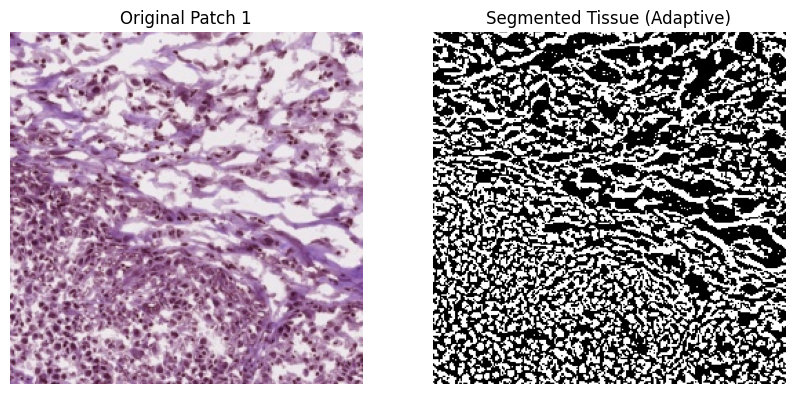

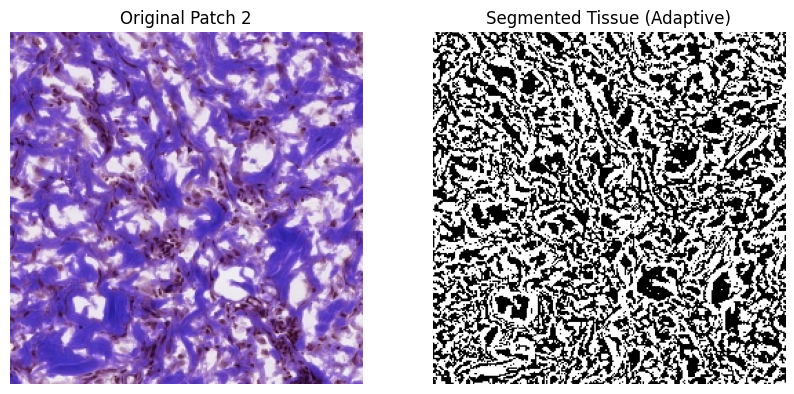

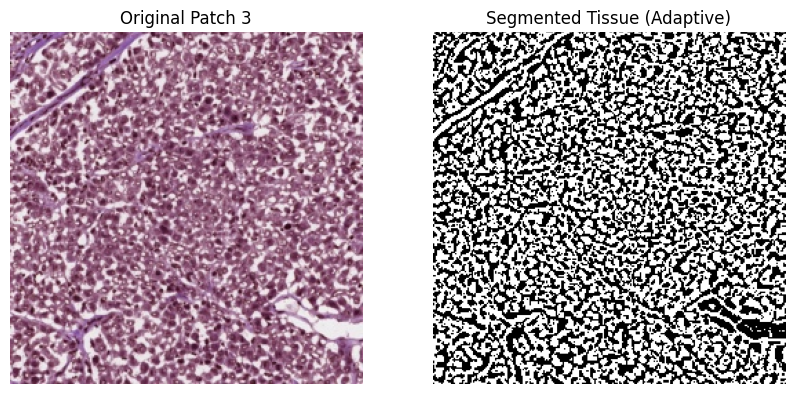

Patch 4 marked as FALSE (insufficient tissue)


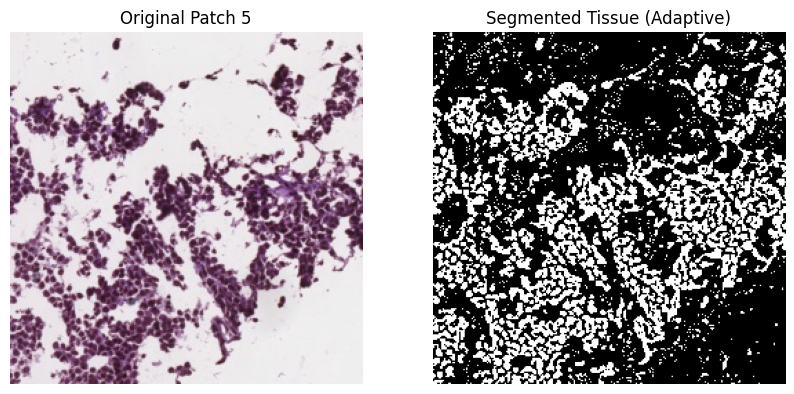

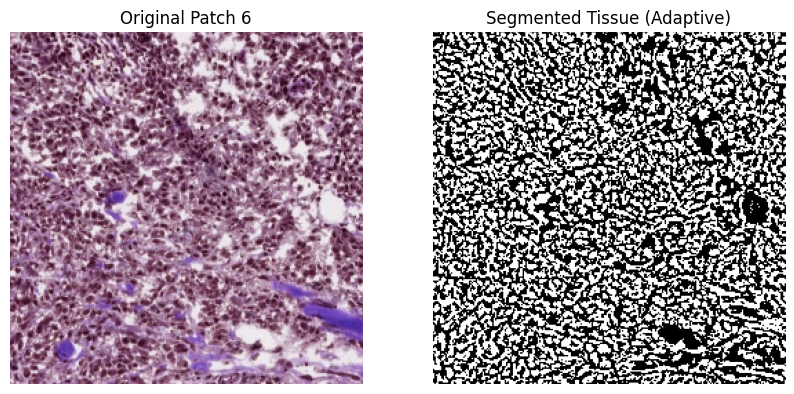

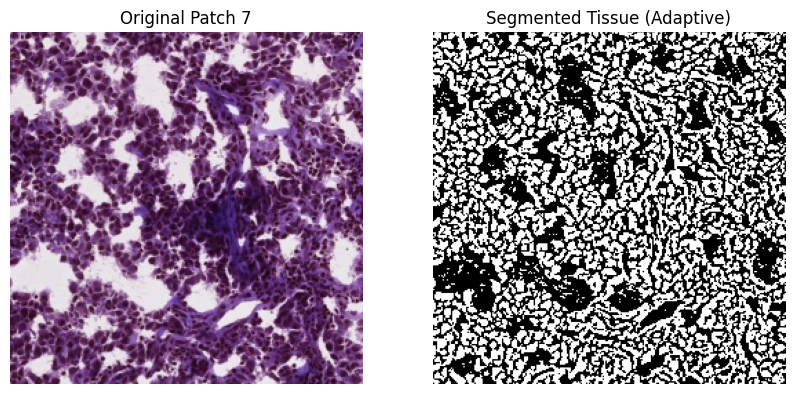

Patch 8 marked as FALSE (insufficient tissue)
Patch 9 marked as FALSE (insufficient tissue)


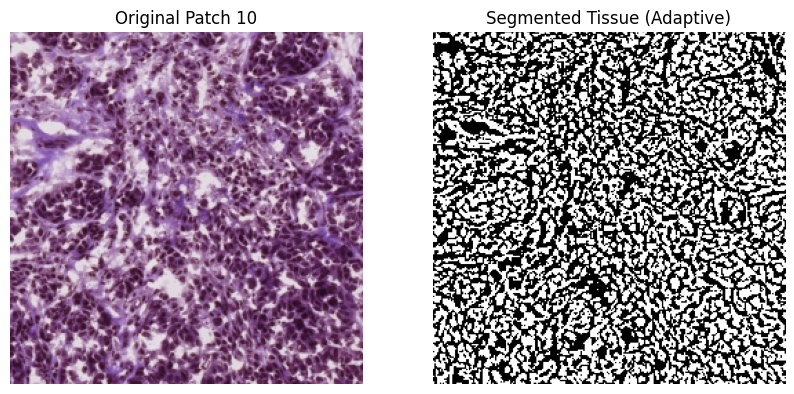

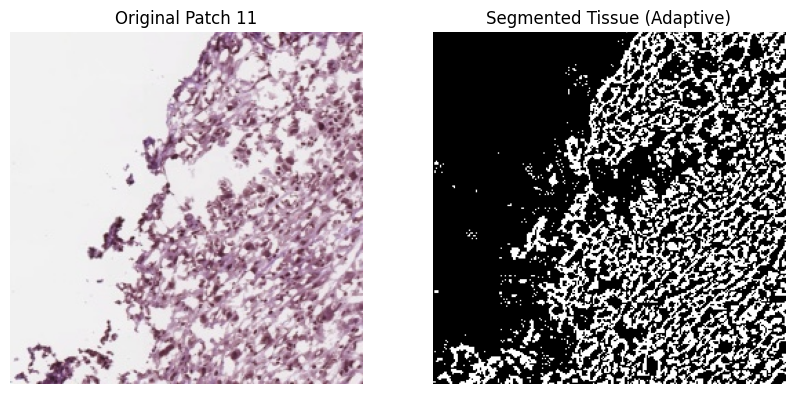

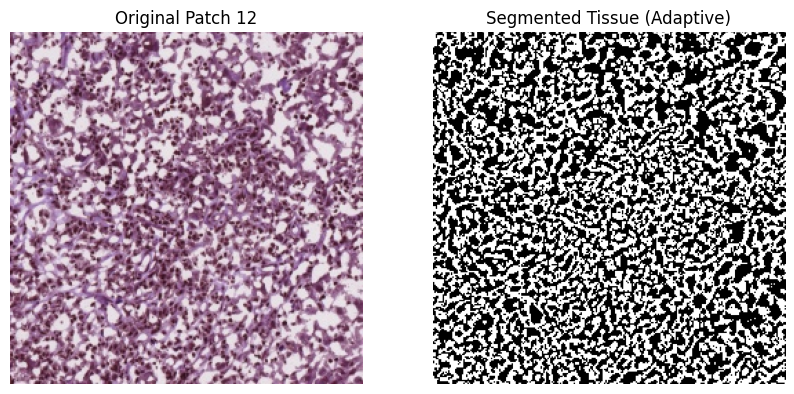

Patch 13 marked as FALSE (insufficient tissue)
Patch 14 marked as FALSE (insufficient tissue)


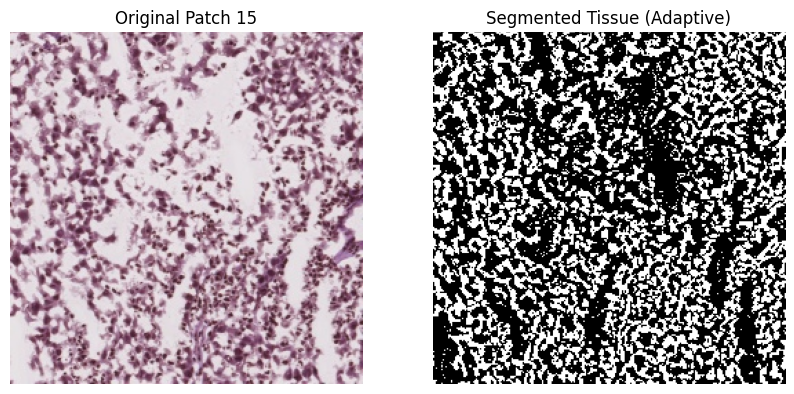

Patch 16 marked as FALSE (insufficient tissue)


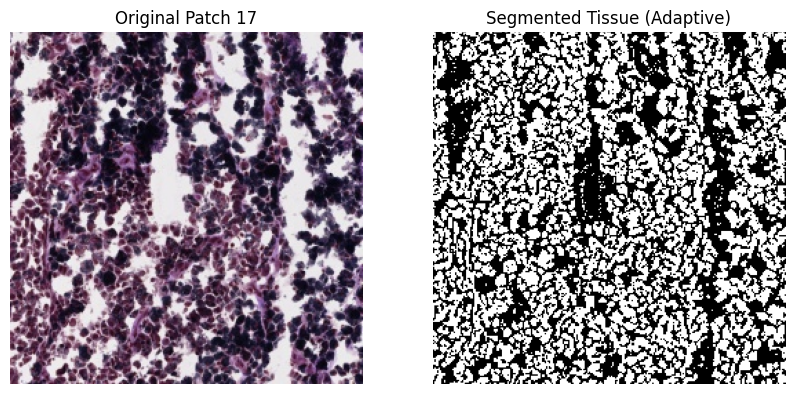

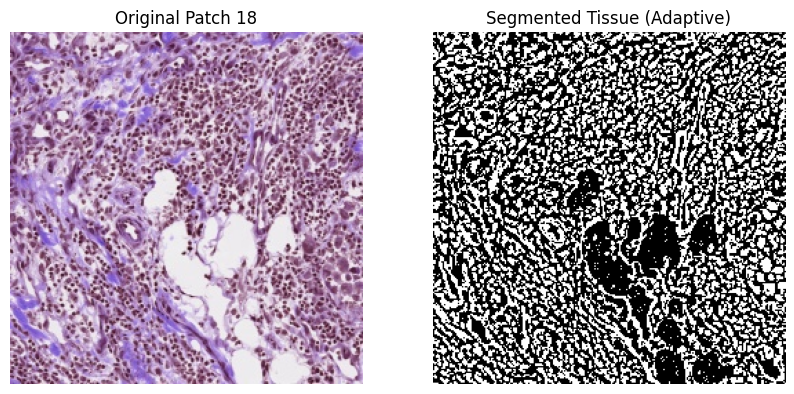

Patch 19 marked as FALSE (insufficient tissue)


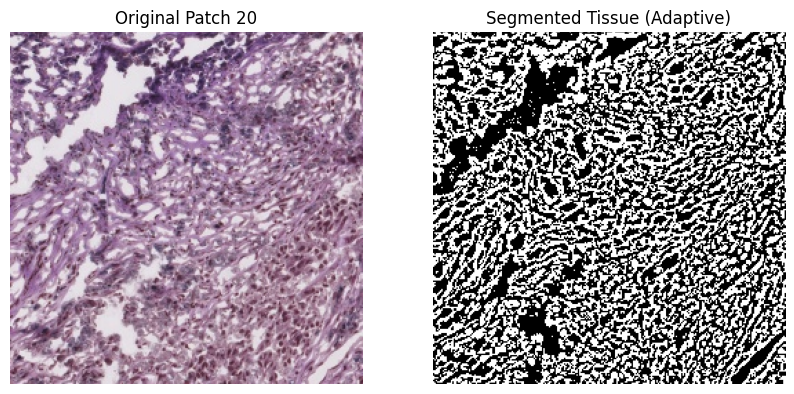

Patch 21 marked as FALSE (insufficient tissue)
Patch 22 marked as FALSE (insufficient tissue)


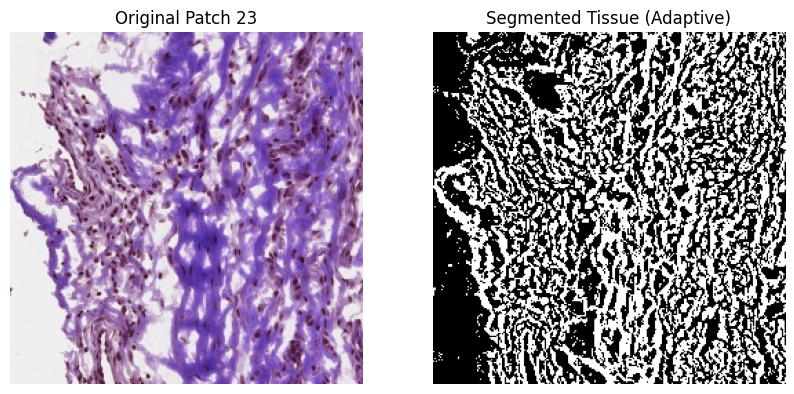

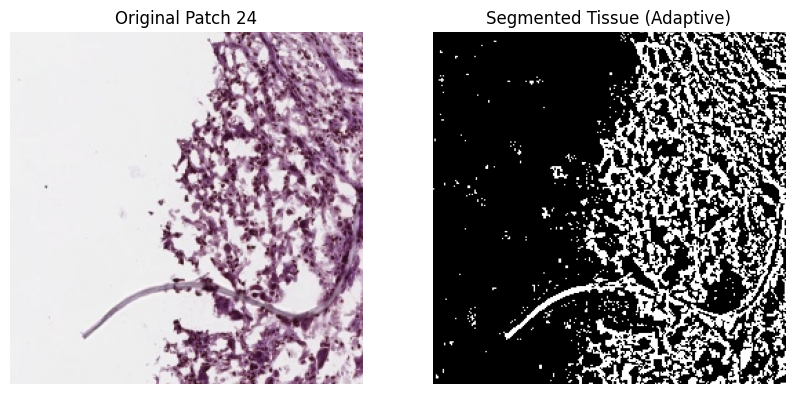

Patch 25 marked as FALSE (insufficient tissue)


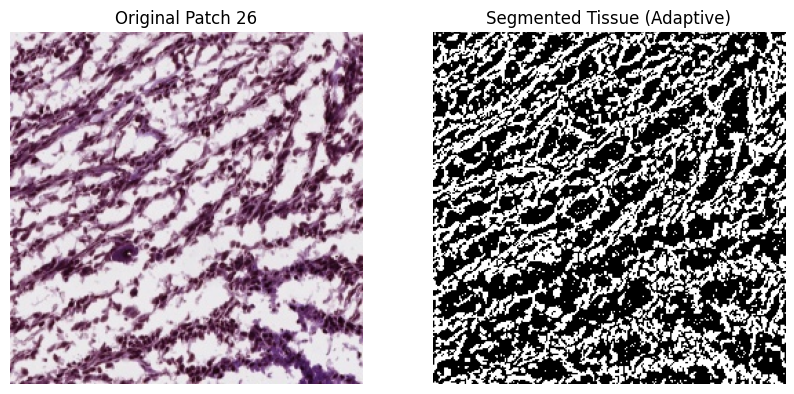

Patch 27 marked as FALSE (insufficient tissue)


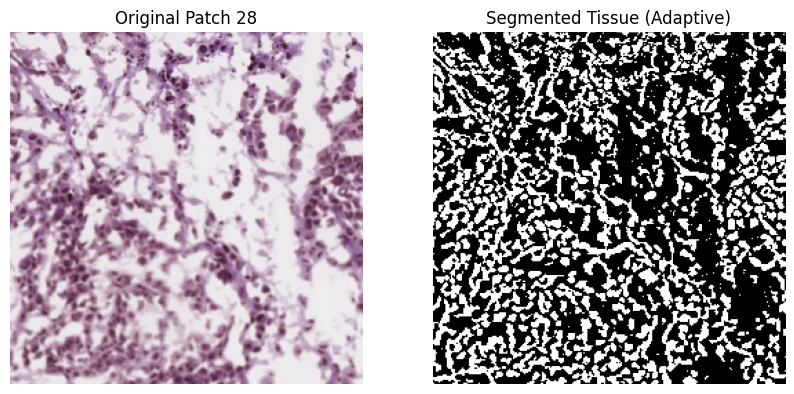

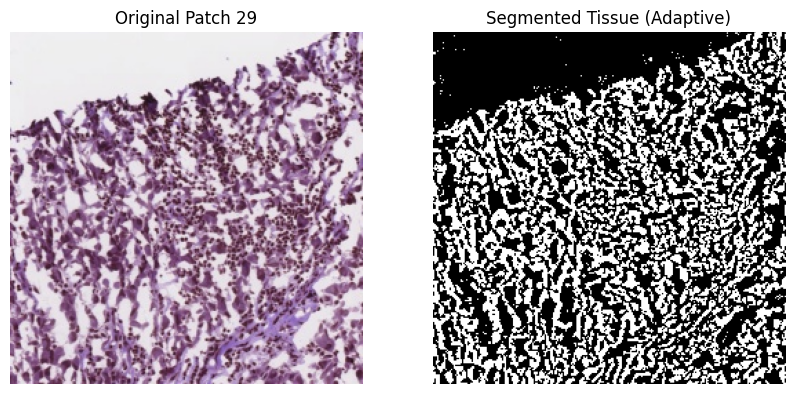

Patch 30 marked as FALSE (insufficient tissue)


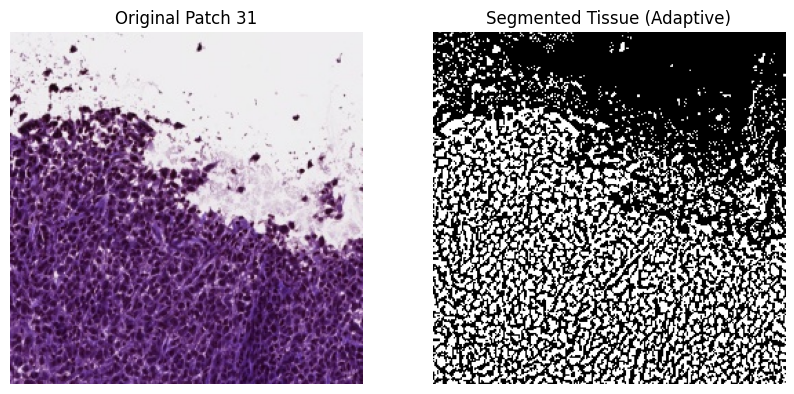

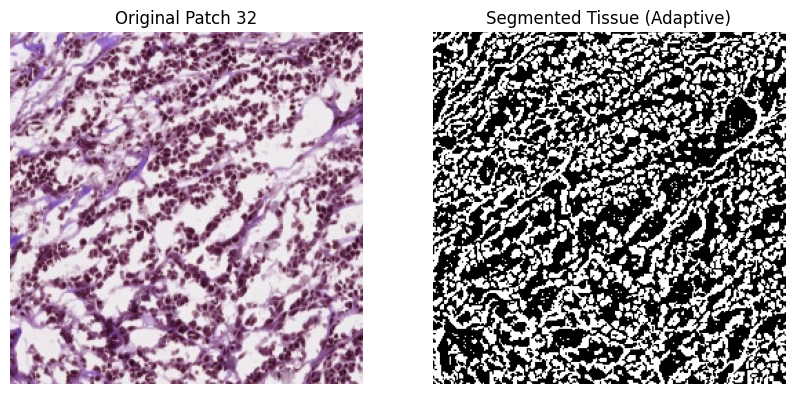

Patch 33 marked as FALSE (insufficient tissue)


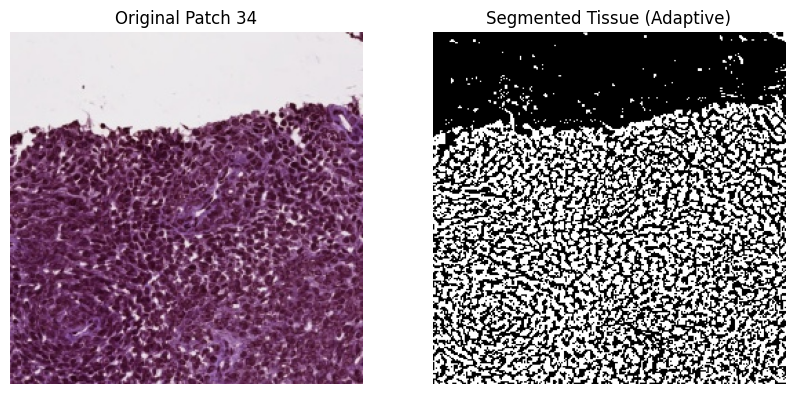

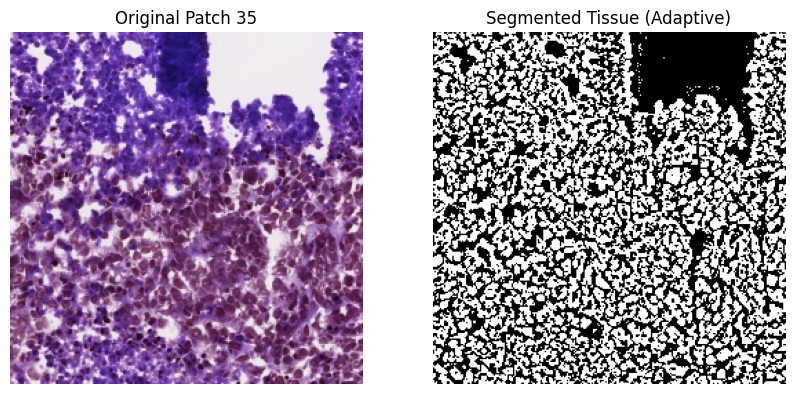

Patch 36 marked as FALSE (insufficient tissue)


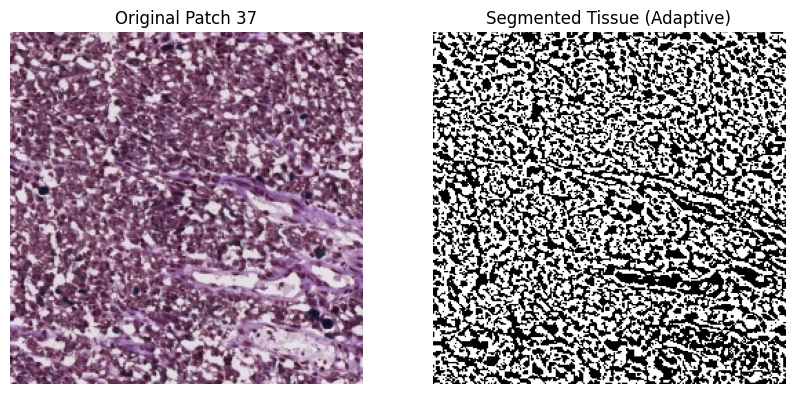

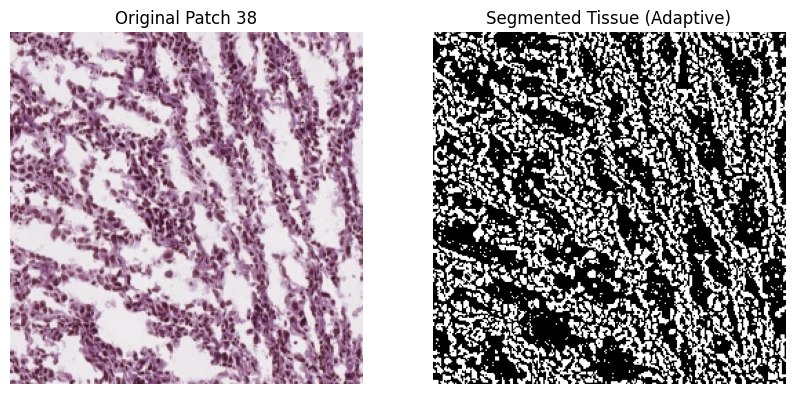

Patch 39 marked as FALSE (insufficient tissue)
Patch 40 marked as FALSE (insufficient tissue)


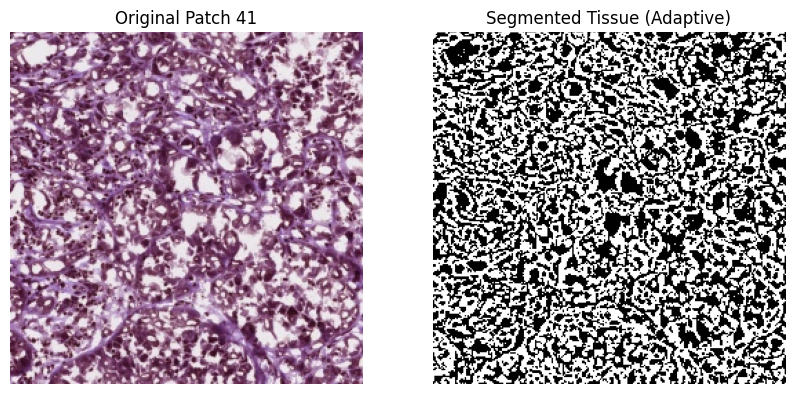

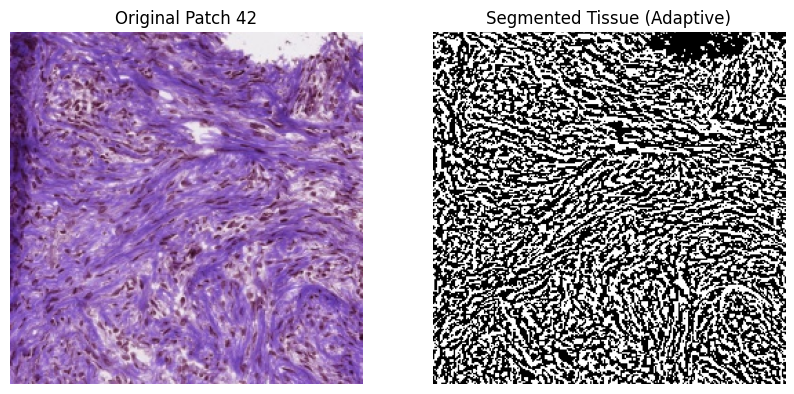

Patch 43 marked as FALSE (insufficient tissue)


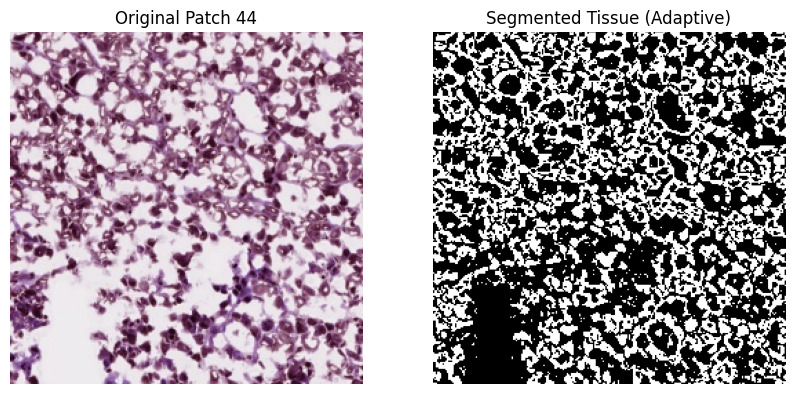

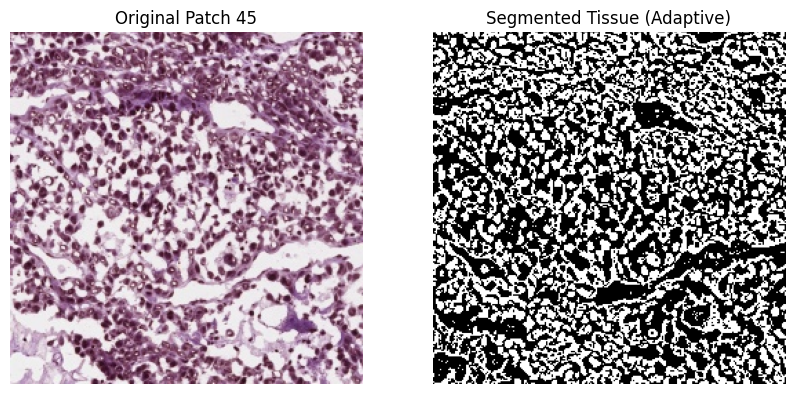

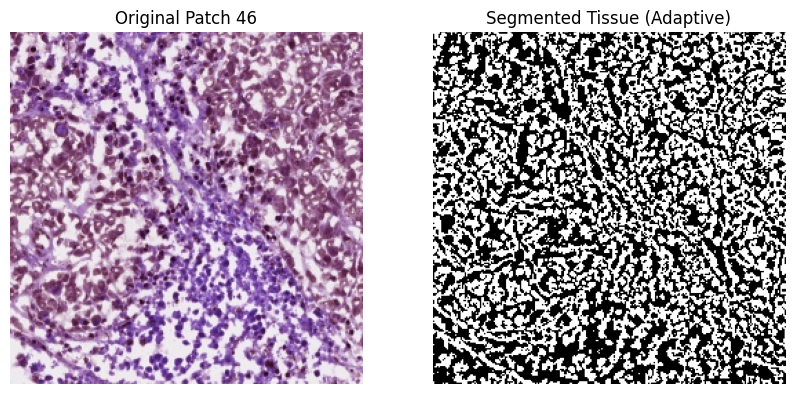

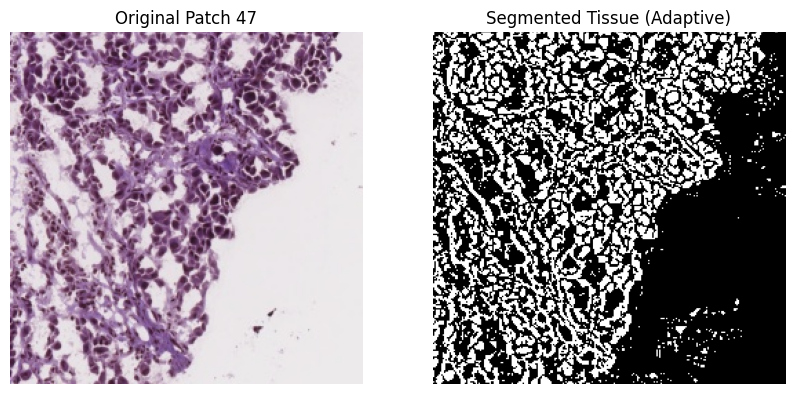

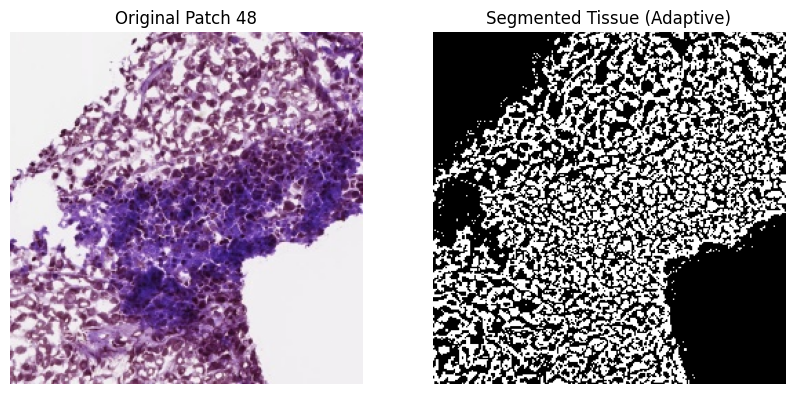

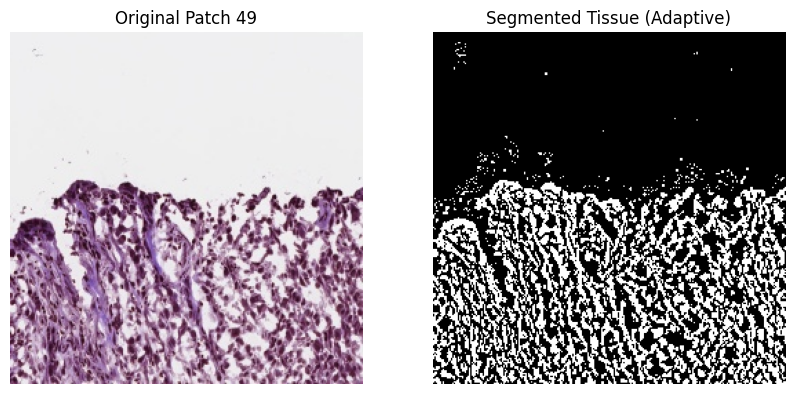

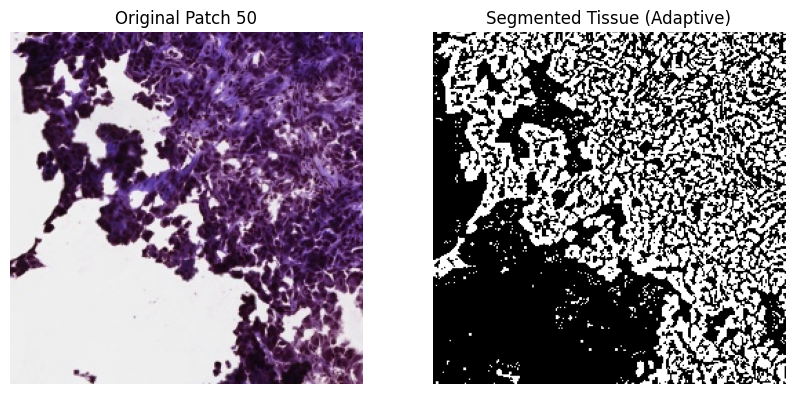

In [ ]:
!pip install opencv-python-headless
!apt-get install -y libsm6 libxext6 libxrender-dev
!pip install tensorflow --upgrade

import os
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt

def segment_tissue_adaptive(image, block_size=11, c=2):
    """
    Segments tissue using adaptive thresholding.
    """
    gray_patch = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    mask = cv2.adaptiveThreshold(gray_patch, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                 cv2.THRESH_BINARY_INV, block_size, c)
    return mask

def load_random_patches(patch_dir, num_patches=50):
    """
    Load a specified number of random patches from a directory.
    """
    patch_files = [f for f in os.listdir(patch_dir) if f.endswith('.jpg')]
    random_files = random.sample(patch_files, num_patches)
    random_patches = [imread(os.path.join(patch_dir, f)) for f in random_files]
    return random_patches

def check_tissue_percentage(mask, threshold=0.20):
    """
    Checks if the foreground tissue percentage in the mask is above a threshold.
    """
    foreground_pixels = np.sum(mask > 0)
    total_pixels = mask.size
    tissue_percentage = foreground_pixels / total_pixels
    return tissue_percentage >= threshold


# --- Main Execution ---
patch_dir = './Extracted_Patches/Metastatic_final'  # Update with your directory
random_patches = load_random_patches(patch_dir, num_patches=50)

for i, patch in enumerate(random_patches):
    mask = segment_tissue_adaptive(patch)

    # Check if the patch is valid based on tissue percentage
    if check_tissue_percentage(mask):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(patch)
        plt.title(f'Original Patch {i+1}')
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(mask, cmap='gray')
        plt.title('Segmented Tissue (Adaptive)')
        plt.axis('off')

        plt.show()
    else:
        print(f"Patch {i+1} marked as FALSE (insufficient tissue)")

In [ ]:
#Filtering patches to make sure the tissue region is at least 10%
import os
import random
import numpy as np
import cv2
from skimage.io import imread
import matplotlib.pyplot as plt
from multiprocessing import Pool

def segment_tissue_adaptive(image, block_size=11, c=2):
    """
    Segments tissue using adaptive thresholding.
    """
    gray_patch = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    mask = cv2.adaptiveThreshold(gray_patch, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                 cv2.THRESH_BINARY_INV, block_size, c)
    return mask

def check_tissue_percentage(mask, threshold=0.10):
    """
    Checks if the foreground tissue percentage in the mask is above a threshold.
    """
    foreground_pixels = np.sum(mask > 0)
    total_pixels = mask.size
    tissue_percentage = foreground_pixels / total_pixels
    return tissue_percentage >= threshold

def process_patch(patch_file, patch_dir, output_dir, threshold=0.10):
    """Processes a single patch."""
    patch_path = os.path.join(patch_dir, patch_file)
    patch = imread(patch_path)
    mask = segment_tissue_adaptive(patch)

    if check_tissue_percentage(mask, threshold):
        output_path = os.path.join(output_dir, patch_file)
        cv2.imwrite(output_path, cv2.cvtColor(patch, cv2.COLOR_RGB2BGR))
    # else:  (Removed the print statement here)

def filter_and_save_patches_parallel(patch_dir, output_dir, threshold=0.10):
    """Filters patches in parallel."""
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    patch_files = [f for f in os.listdir(patch_dir) if f.endswith('.jpg')]

    # Create a pool of worker processes (use the number of CPU cores available)
    with Pool() as pool:
        pool.starmap(process_patch, [(patch_file, patch_dir, output_dir, threshold)
                                        for patch_file in patch_files])

# --- Main Execution ---
patch_dirs = ['./Extracted_Patches/Metastatic_final2', './Extracted_Patches/Primary_final2']
output_dirs = ['./Extracted_Patches/Metastatic_filtered_final2', './Extracted_Patches/Primary_filtered_final2']

for patch_dir, output_dir in zip(patch_dirs, output_dirs):
    filter_and_save_patches_parallel(patch_dir, output_dir)

Random patches from Primary samples:


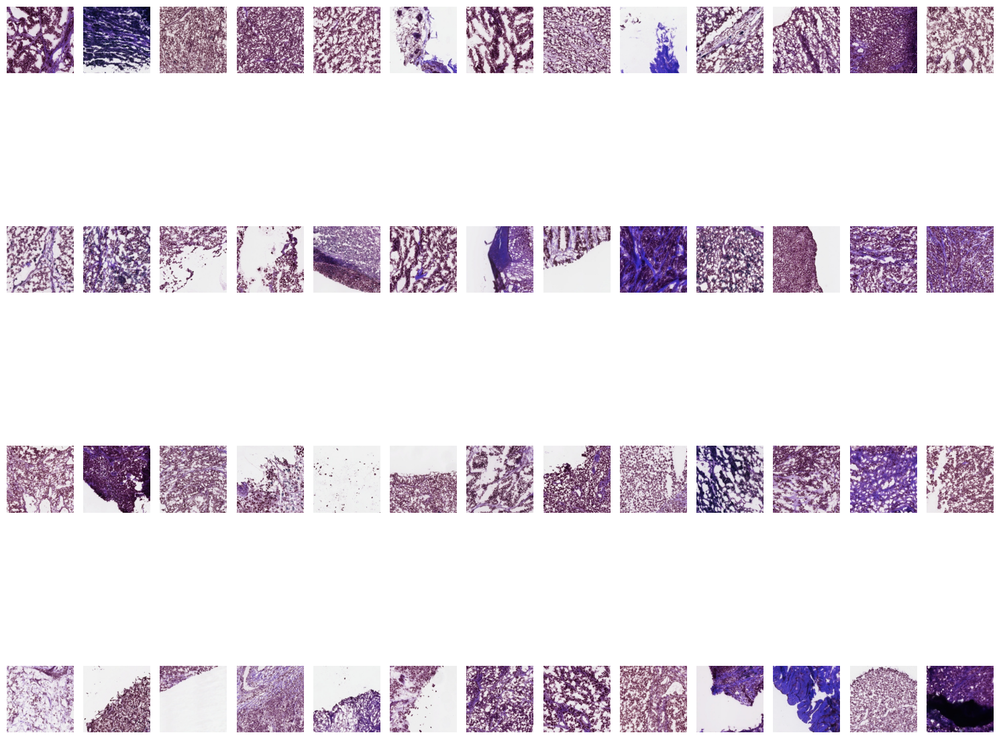

Random patches from Metastatic samples:


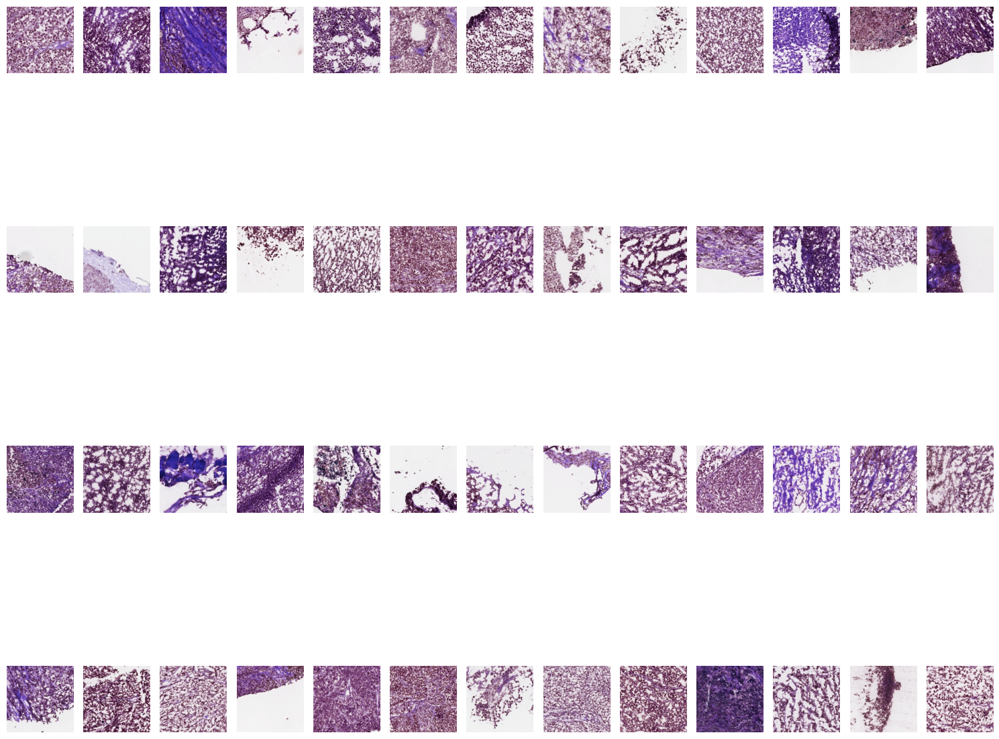

In [3]:
#Seeing the extracted patches
import os
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt

def get_random_patches(patches_dir, num_patches=104):
    # Collect all patches and group them by sample ID (first 12 characters)
    patches = {}
    for filename in os.listdir(patches_dir):
        if filename.endswith('.jpg'):
            sample_id = filename[:12]  # Consider first 12 characters as sample ID
            if sample_id not in patches:
                patches[sample_id] = []
            patches[sample_id].append(filename)

    # Randomly select one patch from each sample until we collect the desired number of patches
    selected_patches = []
    while len(selected_patches) < num_patches and patches:
        sample_id = random.choice(list(patches.keys()))
        if patches[sample_id]:
            selected_patch = random.choice(patches[sample_id])
            selected_patches.append(selected_patch)
            # Remove the selected patch to avoid duplicates
            patches[sample_id].remove(selected_patch)
        # Remove the sample ID if no patches are left
        if not patches[sample_id]:
            del patches[sample_id]

    return selected_patches

def show_patches(patches_dir, selected_patches, num_cols=13):
    num_patches = len(selected_patches)
    num_rows = (num_patches + num_cols - 1) // num_cols  # Ceiling division
    plt.figure(figsize=(15, 15))
    for idx, patch_filename in enumerate(selected_patches):
        patch_filepath = os.path.join(patches_dir, patch_filename)
        patch = cv2.imread(patch_filepath)
        patch_rgb = cv2.cvtColor(patch, cv2.COLOR_BGR2RGB)

        plt.subplot(num_rows, num_cols, idx + 1)
        plt.imshow(patch_rgb)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Directories containing extracted patches
primary_patches_dir = './Extracted_Patches/Primary_filtered_final2'
metastatic_patches_dir = './Extracted_Patches/Metastatic_filtered_final2'

# Get random patches from each directory
random_primary_patches = get_random_patches(primary_patches_dir, num_patches=52)
random_metastatic_patches = get_random_patches(metastatic_patches_dir, num_patches=52)

# Show random patches from Primary
print("Random patches from Primary samples:")
show_patches(primary_patches_dir, random_primary_patches, num_cols=13)

# Show random patches from Metastatic
print("Random patches from Metastatic samples:")
show_patches(metastatic_patches_dir, random_metastatic_patches, num_cols=13)

In [4]:
#Saving canvas of random patches
import os
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt
from PIL import Image  # Importing PIL for image handling

def get_random_patches(patches_dir, num_patches=104):
    patches = {}
    for filename in os.listdir(patches_dir):
        if filename.endswith('.jpg'):
            sample_id = filename[:12]
            if sample_id not in patches:
                patches[sample_id] = []
            patches[sample_id].append(filename)

    selected_patches = []
    while len(selected_patches) < num_patches and patches:
        sample_id = random.choice(list(patches.keys()))
        if patches[sample_id]:
            selected_patch = random.choice(patches[sample_id])
            selected_patches.append(selected_patch)
            patches[sample_id].remove(selected_patch)
        if not patches[sample_id]:
            del patches[sample_id]

    return selected_patches

def show_patches(patches_dir, selected_patches, num_cols=13):
    num_patches = len(selected_patches)
    num_rows = (num_patches + num_cols - 1) // num_cols
    plt.figure(figsize=(15, 15))
    for idx, patch_filename in enumerate(selected_patches):
        patch_filepath = os.path.join(patches_dir, patch_filename)
        patch = cv2.imread(patch_filepath)
        patch_rgb = cv2.cvtColor(patch, cv2.COLOR_BGR2RGB)

        plt.subplot(num_rows, num_cols, idx + 1)
        plt.imshow(patch_rgb)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Saving a canvas of extracted patches
def save_canvas_as_tiff(patches_dir, selected_patches, output_file, dpi=600, num_cols=13):
    images = []
    for patch_filename in selected_patches:
        patch_filepath = os.path.join(patches_dir, patch_filename)
        if not os.path.exists(patch_filepath):
            print(f"File not found: {patch_filepath}")
            continue
        patch = Image.open(patch_filepath)
        images.append(patch)

    if not images:
        print("No valid patches found to save.")
        return

    num_patches = len(images)
    num_rows = (num_patches + num_cols - 1) // num_cols
    patch_width, patch_height = images[0].size
    canvas_width = num_cols * patch_width
    canvas_height = num_rows * patch_height

    canvas = Image.new('RGB', (canvas_width, canvas_height), (255, 255, 255))

    for idx, patch in enumerate(images):
        x = (idx % num_cols) * patch_width
        y = (idx // num_cols) * patch_height
        canvas.paste(patch, (x, y))

    canvas.save(output_file, dpi=(dpi, dpi))

    absolute_path = os.path.abspath(output_file)
    print(f"Saved canvas to {absolute_path} at {dpi} DPI.")

# Directories containing extracted patches
primary_patches_dir = './Extracted_Patches/Primary_filtered_final2'
metastatic_patches_dir = './Extracted_Patches/Metastatic_filtered_final2'

# Get random patches from each directory
random_primary_patches = get_random_patches(primary_patches_dir, num_patches=52)
random_metastatic_patches = get_random_patches(metastatic_patches_dir, num_patches=52)

# Save a canvas with patches
output_file_primary = 'primary_patches_final_canvas.tiff'
output_file_metastatic = 'metastatic_patches_final_canvas.tiff'

# Saving the canvas with primary patches
save_canvas_as_tiff(primary_patches_dir, random_primary_patches, output_file_primary, dpi=600)

# Saving the canvas with metastatic patches
save_canvas_as_tiff(metastatic_patches_dir, random_metastatic_patches, output_file_metastatic, dpi=600)


Saved canvas to /content/drive/MyDrive/TCGA_SKCM_WSI/primary_patches_final_canvas.tiff at 600 DPI.
Saved canvas to /content/drive/MyDrive/TCGA_SKCM_WSI/metastatic_patches_final_canvas.tiff at 600 DPI.


In [ ]:
import os

def count_files(directory):
    """Counts the number of files in a directory."""
    return len([f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))])

patch_dirs = [
    './Extracted_Patches/Metastatic_final2',
    './Extracted_Patches/Primary_final2',
    './Extracted_Patches/Metastatic_filtered_final2',
    './Extracted_Patches/Primary_filtered_final2'
]

for directory in patch_dirs:
    file_count = count_files(directory)
    print(f"Number of files in '{directory}': {file_count}")

Number of files in './Extracted_Patches/Metastatic_final2': 22137
Number of files in './Extracted_Patches/Primary_final2': 24933
Number of files in './Extracted_Patches/Metastatic_filtered_final2': 16083
Number of files in './Extracted_Patches/Primary_filtered_final2': 17746


Epoch 1/25


Training batches: 403it [11:21,  1.69s/it]


Epoch average loss: 0.8165076140679186
Training loss: 0.8165076140679186
Epoch 2/25


Training batches: 403it [08:34,  1.28s/it]


Epoch average loss: 0.7267652153229299
Training loss: 0.7267652153229299
Epoch 3/25


Training batches: 403it [08:34,  1.28s/it]


Epoch average loss: 0.7072186668960392
Training loss: 0.7072186668960392
Epoch 4/25


Training batches: 403it [08:34,  1.28s/it]


Epoch average loss: 0.7057259252142374
Training loss: 0.7057259252142374
Epoch 5/25


Training batches: 403it [08:35,  1.28s/it]


Epoch average loss: 0.7365779496784838
Training loss: 0.7365779496784838
Epoch 6/25


Training batches: 403it [08:36,  1.28s/it]


Epoch average loss: 0.6996431471987931
Training loss: 0.6996431471987931
Epoch 7/25


Training batches: 403it [08:34,  1.28s/it]


Epoch average loss: 0.6980081468302913
Training loss: 0.6980081468302913
Epoch 8/25


Training batches: 403it [08:37,  1.28s/it]


Epoch average loss: 0.6957089636964774
Training loss: 0.6957089636964774
Epoch 9/25


Training batches: 403it [08:52,  1.32s/it]


Epoch average loss: 0.6994849868654909
Training loss: 0.6994849868654909
Epoch 10/25


Training batches: 403it [08:44,  1.30s/it]


Epoch average loss: 0.6947022543355785
Training loss: 0.6947022543355785
Epoch 11/25


Training batches: 403it [08:36,  1.28s/it]


Epoch average loss: 0.6932857181534874
Training loss: 0.6932857181534874
Epoch 12/25


Training batches: 403it [08:35,  1.28s/it]


Epoch average loss: 0.6931784777132513
Training loss: 0.6931784777132513
Epoch 13/25


Training batches: 403it [08:37,  1.28s/it]


Epoch average loss: 0.6931763706964535
Training loss: 0.6931763706964535
Epoch 14/25


Training batches: 403it [08:35,  1.28s/it]


Epoch average loss: 0.6931493384370733
Training loss: 0.6931493384370733
Epoch 15/25


Training batches: 403it [08:36,  1.28s/it]


Epoch average loss: 0.6931471602792479
Training loss: 0.6931471602792479
Epoch 16/25


Training batches: 403it [08:37,  1.28s/it]


Epoch average loss: 0.6931471096966462
Training loss: 0.6931471096966462
Epoch 17/25


Training batches: 403it [08:33,  1.27s/it]


Epoch average loss: 0.693147152588326
Training loss: 0.693147152588326
Epoch 18/25


Training batches: 403it [08:36,  1.28s/it]


Epoch average loss: 0.6931468878431296
Training loss: 0.6931468878431296
Epoch 19/25


Training batches: 403it [08:36,  1.28s/it]


Epoch average loss: 0.6931958590488576
Training loss: 0.6931958590488576
Epoch 20/25


Training batches: 403it [08:34,  1.28s/it]


Epoch average loss: 0.6931591956846176
Training loss: 0.6931591956846176
Epoch 21/25


Training batches: 403it [08:36,  1.28s/it]


Epoch average loss: 0.693147228610131
Training loss: 0.693147228610131
Epoch 22/25


Training batches: 403it [08:37,  1.28s/it]


Epoch average loss: 0.6931474949822533
Training loss: 0.6931474949822533
Epoch 23/25


Training batches: 403it [08:38,  1.29s/it]


Epoch average loss: 0.9736737871586629
Training loss: 0.9736737871586629
Epoch 24/25


Training batches: 403it [08:40,  1.29s/it]


Epoch average loss: 0.7137417285229373
Training loss: 0.7137417285229373
Epoch 25/25


Training batches: 403it [08:38,  1.29s/it]


Epoch average loss: 0.6957335421820137
Training loss: 0.6957335421820137


Processing test patches in ./Extracted_Patches/Metastatic_filtered_final2: 101it [00:25,  3.94it/s]


Epoch 1/25


Training batches: 444it [12:23,  1.67s/it]


Epoch average loss: 0.7014694599149464
Training loss: 0.7014694599149464
Epoch 2/25


Training batches: 444it [09:30,  1.29s/it]


Epoch average loss: 0.6954681867951745
Training loss: 0.6954681867951745
Epoch 3/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.6946466463106172
Training loss: 0.6946466463106172
Epoch 4/25


Training batches: 444it [09:27,  1.28s/it]


Epoch average loss: 0.6946961549488274
Training loss: 0.6946961549488274
Epoch 5/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.6933305983070854
Training loss: 0.6933305983070854
Epoch 6/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.693592251018361
Training loss: 0.693592251018361
Epoch 7/25


Training batches: 444it [09:28,  1.28s/it]


Epoch average loss: 0.6932153043983219
Training loss: 0.6932153043983219
Epoch 8/25


Training batches: 444it [09:27,  1.28s/it]


Epoch average loss: 0.6932046170438733
Training loss: 0.6932046170438733
Epoch 9/25


Training batches: 444it [09:30,  1.28s/it]


Epoch average loss: 0.6934034590785568
Training loss: 0.6934034590785568
Epoch 10/25


Training batches: 444it [09:28,  1.28s/it]


Epoch average loss: 0.6931424197312948
Training loss: 0.6931424197312948
Epoch 11/25


Training batches: 444it [09:28,  1.28s/it]


Epoch average loss: 0.7312100967540548
Training loss: 0.7312100967540548
Epoch 12/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.7159483628777519
Training loss: 0.7159483628777519
Epoch 13/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.7124446821105372
Training loss: 0.7124446821105372
Epoch 14/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.7001770426695412
Training loss: 0.7001770426695412
Epoch 15/25


Training batches: 444it [09:30,  1.29s/it]


Epoch average loss: 0.6958533679177096
Training loss: 0.6958533679177096
Epoch 16/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.6990011934493039
Training loss: 0.6990011934493039
Epoch 17/25


Training batches: 444it [09:30,  1.28s/it]


Epoch average loss: 0.6923692298902048
Training loss: 0.6923692298902048
Epoch 18/25


Training batches: 444it [09:30,  1.28s/it]


Epoch average loss: 0.6940839361768585
Training loss: 0.6940839361768585
Epoch 19/25


Training batches: 444it [09:30,  1.29s/it]


Epoch average loss: 0.6942529009806143
Training loss: 0.6942529009806143
Epoch 20/25


Training batches: 444it [09:30,  1.29s/it]


Epoch average loss: 0.6940631714758573
Training loss: 0.6940631714758573
Epoch 21/25


Training batches: 444it [09:32,  1.29s/it]


Epoch average loss: 0.6958224808310604
Training loss: 0.6958224808310604
Epoch 22/25


Training batches: 444it [09:35,  1.30s/it]


Epoch average loss: 0.6949191913679913
Training loss: 0.6949191913679913
Epoch 23/25


Training batches: 444it [09:33,  1.29s/it]


Epoch average loss: 0.6937623872413291
Training loss: 0.6937623872413291
Epoch 24/25


Training batches: 444it [09:29,  1.28s/it]


Epoch average loss: 0.6932854633610528
Training loss: 0.6932854633610528
Epoch 25/25


Training batches: 444it [09:28,  1.28s/it]


Epoch average loss: 0.6932967029981785
Training loss: 0.6932967029981785


Processing test patches in ./Extracted_Patches/Primary_filtered_final2: 111it [00:28,  3.86it/s]


Plot saved at: /content/drive/MyDrive/TCGA_SKCM_WSI/training_loss_plot_25_epochs_newfiltered.png


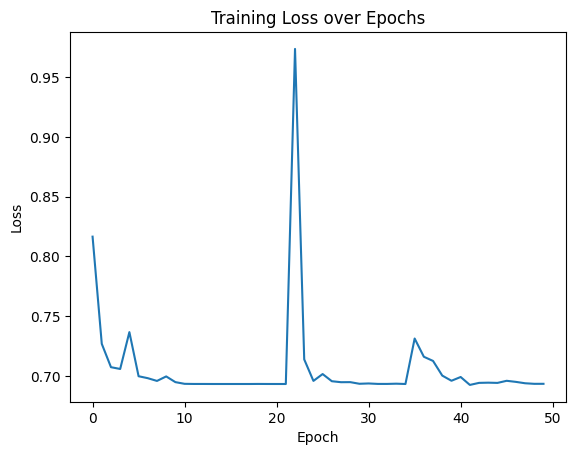

KeyboardInterrupt: 

In [ ]:
#Feature extraction with filtered patches
import os
import signal
import sys
import numpy as np
import tensorflow as tf
from tqdm import tqdm
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from sklearn.model_selection import train_test_split
from PIL import Image
import matplotlib.pyplot as plt

# --- Define Input Shape ---
input_shape = (224, 224, 3)

# --- Build ResNet Model ---
def build_resnet_model(input_shape):
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
    x = base_model.output
    x = layers.GlobalAveragePooling2D()(x)
    model = Model(inputs=base_model.input, outputs=x)
    return model

# --- Load ResNet50 Model ---
resnet_model = build_resnet_model(input_shape)

# --- Unfreeze the last 50 layers for fine-tuning ---
for layer in resnet_model.layers[-50:]:
    layer.trainable = True

# --- Optimizer ---
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)

# --- Function to preprocess images ---
def preprocess_image(image_path):
    try:
        image = Image.open(image_path)
        image = image.resize((224, 224))
        image = np.array(image)
        return tf.keras.applications.resnet50.preprocess_input(image)
    except Exception as e:
        print(f"Skipping corrupted image: {image_path} - Error: {e}")
        return None

# --- Create TensorFlow Dataset ---
def create_dataset(patch_paths, labels, batch_size):
    def generator():
        for path, label in zip(patch_paths, labels):
            image = preprocess_image(path)
            if image is not None:
                yield image, label

    dataset = tf.data.Dataset.from_generator(generator,
                                             output_signature=(tf.TensorSpec(shape=(224, 224, 3), dtype=tf.float32),
                                                              tf.TensorSpec(shape=(), dtype=tf.float32)))
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    return dataset

# --- Feature Extraction and Fine-tuning ---
def extract_and_finetune_batch(dataset, resnet_model, optimizer):
    total_loss = 0
    num_batches = 0
    for batch_images, batch_labels in tqdm(dataset, desc="Training batches"):
        with tf.GradientTape() as tape:
            # ResNet50 Feature Extraction
            resnet_features = resnet_model(batch_images)

            # Classification Layer
            logits = layers.Dense(1, activation='sigmoid')(resnet_features)

            # Calculate Loss
            loss_fn = tf.keras.losses.BinaryCrossentropy()
            loss = loss_fn(batch_labels, logits)

        # Backpropagation and Weight Update
        gradients = tape.gradient(loss, resnet_model.trainable_variables)
        optimizer.apply_gradients(zip(gradients, resnet_model.trainable_variables))

        total_loss += loss.numpy()
        num_batches += 1

    avg_loss = total_loss / num_batches if num_batches > 0 else 0
    print(f"Epoch average loss: {avg_loss}")
    return avg_loss

# --- Function to disconnect the runtime ---
def disconnect_runtime():
    os.kill(os.getpid(), signal.SIGINT)

# --- Main Execution ---
if __name__ == "__main__":
    primary_patches_dir = './Extracted_Patches/Primary_filtered_final2'
    metastatic_patches_dir = './Extracted_Patches/Metastatic_filtered_final2'
    batch_size = 32

    best_loss = float('inf')
    loss_history = []

    patch_dirs = [metastatic_patches_dir, primary_patches_dir]

    for patch_dir in patch_dirs:
        patch_paths = [os.path.join(patch_dir, f) for f in os.listdir(patch_dir) if f.endswith('.jpg')]
        labels = [1 if "Metastatic" in patch_dir else 0] * len(patch_paths)

        # Split patch paths into train and test sets
        train_patch_paths, test_patch_paths = train_test_split(patch_paths, test_size=0.2, random_state=42)

        # Create datasets
        train_dataset = create_dataset(train_patch_paths, labels[:len(train_patch_paths)], batch_size)
        test_dataset = create_dataset(test_patch_paths, labels[len(train_patch_paths):], batch_size)

        # --- Feature extraction and fine-tuning for training set ---
        for epoch in range(25):
            print(f"Epoch {epoch + 1}/25")
            loss = extract_and_finetune_batch(train_dataset, resnet_model, optimizer)
            print(f"Training loss: {loss}")
            loss_history.append(loss)

            if loss < best_loss:
                best_loss = loss
                resnet_model.save(f"finetuned_resnet_model_best_epoch_{epoch + 1}_25_epochs_newfiltered.h5")

        # --- Feature extraction for test set ---
        all_features_test = []
        all_labels_test = []
        for batch_images, batch_labels in tqdm(test_dataset, desc=f"Processing test patches in {patch_dir}"):
            features = resnet_model(batch_images)
            all_features_test.append(features.numpy())
            all_labels_test.append(batch_labels.numpy())

        # Convert to NumPy arrays and save
        all_features_test = np.concatenate(all_features_test, axis=0)
        all_labels_test = np.concatenate(all_labels_test, axis=0)

        np.save(os.path.join(patch_dir, "all_features_test_finetuned_50_layers_25_epochs_newfiltered.npy"), all_features_test)
        np.save(os.path.join(patch_dir, "all_labels_test_finetuned_50_layers_25_epochs_newfiltered.npy"), all_labels_test)

    # Save the final model state
    resnet_model.save("finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5")

    # --- Plot the loss history ---
    plt.plot(loss_history)
    plt.title('Training Loss over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    save_path = "training_loss_plot_25_epochs_newfiltered.png"
    plt.savefig(save_path)
    print(f"Plot saved at: {os.path.abspath(save_path)}")
    plt.show()

    # Disconnect the runtime after the code is finished
    disconnect_runtime()

Model loaded from: finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5


Evaluating: 212it [03:26,  1.03it/s]


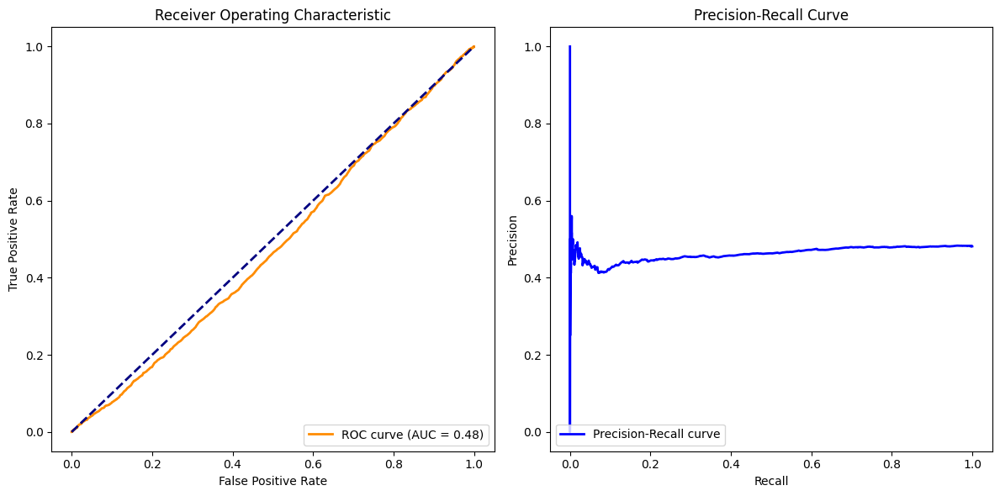

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras import layers, Model
from sklearn.model_selection import train_test_split
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve
from tqdm import tqdm

# --- Function to preprocess images ---
def preprocess_image(image_path):
    image = Image.open(image_path)
    image = image.resize((224, 224))  # Resize image
    image = np.array(image)
    return tf.keras.applications.resnet50.preprocess_input(image)

# --- Create TensorFlow Dataset ---
def create_dataset(patch_paths, labels, batch_size):
    def generator():
        for path, label in zip(patch_paths, labels):
            yield preprocess_image(path), label

    dataset = tf.data.Dataset.from_generator(generator,
                                             output_signature=(tf.TensorSpec(shape=(224, 224, 3), dtype=tf.float32),
                                                               tf.TensorSpec(shape=(), dtype=tf.float32)))
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    return dataset

# --- Load Fine-tuned Model and Add Classification Layer ---
def load_trained_model_with_classifier(model_path):
    # Load the base model without compiling
    model = load_model(model_path, compile=False)
    print(f"Model loaded from: {model_path}")

    # Get the output of the last convolutional layer
    x = model.get_layer('conv5_block3_out').output  # Use the correct layer name

    # Add a classification layer
    x = layers.GlobalAveragePooling2D()(x)  # Often needed after convolutional layers
    x = layers.Dense(1, activation='sigmoid', name='predictions')(x)

    # Create the new model
    model_with_classifier = Model(inputs=model.input, outputs=x)
    return model_with_classifier

# --- Evaluate the Model ---
def evaluate_model(model, test_dataset):
    all_true_labels = []
    all_predictions = []

    for batch_images, batch_labels in tqdm(test_dataset, desc="Evaluating"):
        predictions = model(batch_images, training=False)  # Ensure no training updates

        all_predictions.append(predictions.numpy().flatten())  # Flatten predictions for concatenation
        all_true_labels.append(batch_labels.numpy())  # Store true labels

    # Check if predictions were made
    if not all_predictions:
        print("No predictions were made. Check the model or the input data.")
        return np.array([]), np.array([])  # Return empty arrays if no predictions were made

    # Convert lists to numpy arrays
    all_predictions = np.concatenate(all_predictions, axis=0)
    all_true_labels = np.concatenate(all_true_labels, axis=0)

    return all_true_labels, all_predictions

# --- Plot ROC and PR Curves ---
def plot_roc_pr_curves(true_labels, predictions):
    # ROC Curve
    fpr, tpr, _ = roc_curve(true_labels, predictions)
    roc_auc = auc(fpr, tpr)

    # Plot ROC
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")

    # Precision-Recall Curve
    precision, recall, _ = precision_recall_curve(true_labels, predictions)

    # Plot PR
    plt.subplot(1, 2, 2)
    plt.plot(recall, precision, color='blue', lw=2, label='Precision-Recall curve')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="lower left")

    plt.tight_layout()
    plt.show()

# --- Main Execution ---
if __name__ == "__main__":
    primary_patches_dir = './Extracted_Patches/Primary_filtered_final2'
    metastatic_patches_dir = './Extracted_Patches/Metastatic_filtered_final2'
    batch_size = 32  # Adjust batch size as needed

    # Load both primary and metastatic patches
    patch_dirs = [metastatic_patches_dir, primary_patches_dir]

    all_patch_paths = []
    all_labels = []

    for patch_dir in patch_dirs:
        # Load test patches
        patch_paths = [os.path.join(patch_dir, f) for f in os.listdir(patch_dir) if f.endswith('.jpg')]
        labels = [1 if "Metastatic" in patch_dir else 0] * len(patch_paths)

        all_patch_paths.extend(patch_paths)
        all_labels.extend(labels)

    # Split into train/test sets
    train_patch_paths, test_patch_paths, train_labels, test_labels = train_test_split(
        all_patch_paths, all_labels, test_size=0.2, random_state=42
    )

    # Create the test dataset
    test_dataset = create_dataset(test_patch_paths, test_labels, batch_size)

    # Load the saved fine-tuned model
    model_path = "finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5"  # Path to your saved model
    loaded_model = load_trained_model_with_classifier(model_path)

    # Evaluate the model on the test dataset
    all_true_labels, all_predictions = evaluate_model(loaded_model, test_dataset)

    if all_predictions.size > 0:  # Check if predictions were made
        # Plot ROC and PR curves
        plot_roc_pr_curves(all_true_labels, all_predictions)
    else:
        print("No predictions to plot.")


FileUpload(value={}, accept='.jpg,.jpeg,.png', description='Upload')

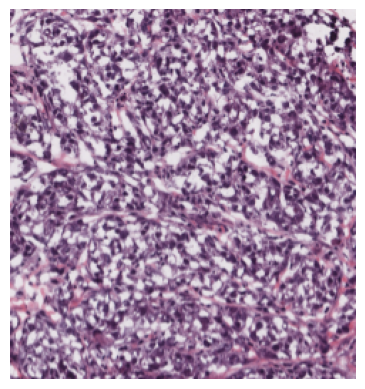

Model loaded from: finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5
Prediction: **Metastatic** (Probability: 0.50)


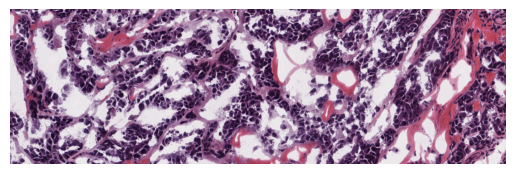

Model loaded from: finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5
Prediction: **Primary** (Probability: 0.51)


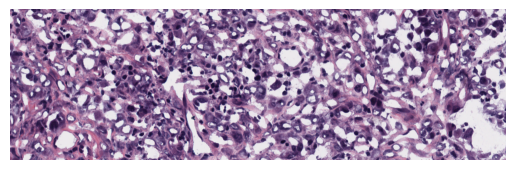

Model loaded from: finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5
Prediction: **Metastatic** (Probability: 0.51)


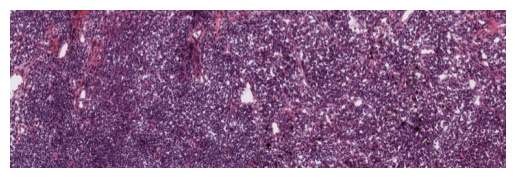

Model loaded from: finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5
Prediction: **Primary** (Probability: 0.51)


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras import layers
from PIL import Image
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display
import io

# Load the fine-tuned model with classification layer
def load_trained_model_with_classifier(model_path):
    model = load_model(model_path, compile=False)
    print(f"Model loaded from: {model_path}")

    # Get the output of the last convolutional layer
    x = model.get_layer('conv5_block3_out').output  # Use the correct layer name
    x = layers.GlobalAveragePooling2D()(x)  # Global average pooling
    x = layers.Dense(1, activation='sigmoid', name='predictions')(x)

    # Create the new model
    model_with_classifier = tf.keras.Model(inputs=model.input, outputs=x)
    return model_with_classifier

# Preprocess image for prediction
def preprocess_image(image):
    image = image.convert('RGB')  # Convert to RGB format
    image = image.resize((224, 224))  # Resize image to match input shape
    image = np.array(image)
    image = tf.keras.applications.resnet50.preprocess_input(image)  # Preprocess for ResNet
    return np.expand_dims(image, axis=0)  # Add batch dimension

# Predict the class of the image
def predict_image(model, image):
    processed_image = preprocess_image(image)
    prediction = model(processed_image, training=False)  # Use the model for prediction
    return prediction.numpy()[0][0]  # Return the prediction value

# Function to handle file upload and prediction
def handle_file_upload(change):
    uploaded_files = change['new']
    if uploaded_files:
        # Process each uploaded file
        for filename, fileinfo in uploaded_files.items():
            # Read the uploaded file content into a PIL image
            image_data = io.BytesIO(fileinfo['content'])
            image = Image.open(image_data)  # Open the uploaded image

            plt.imshow(image)
            plt.axis('off')
            plt.show()

            # Load the model
            model_path = "finetuned_resnet_model_50_layers_25_epochs_newfiltered.h5"
            model = load_trained_model_with_classifier(model_path)

            # Make a prediction
            prediction = predict_image(model, image)

            # Display the prediction result
            if prediction >= 0.5:
                print("Prediction: **Metastatic** (Probability: {:.2f})".format(prediction))
            else:
                print("Prediction: **Primary** (Probability: {:.2f})".format(1 - prediction))

# Create file upload widget
file_upload = widgets.FileUpload(
    accept='.jpg,.jpeg,.png',  # Accepted file types
    multiple=False  # Set to False for single file upload
)

# Attach the upload handler
file_upload.observe(handle_file_upload, names='value')

# Display the file upload widget
display(file_upload)
